<a href="https://colab.research.google.com/github/AAKAAASSHHH24/Computer-Vision/blob/main/OpenCV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

width=1500, height=1000, depth=3


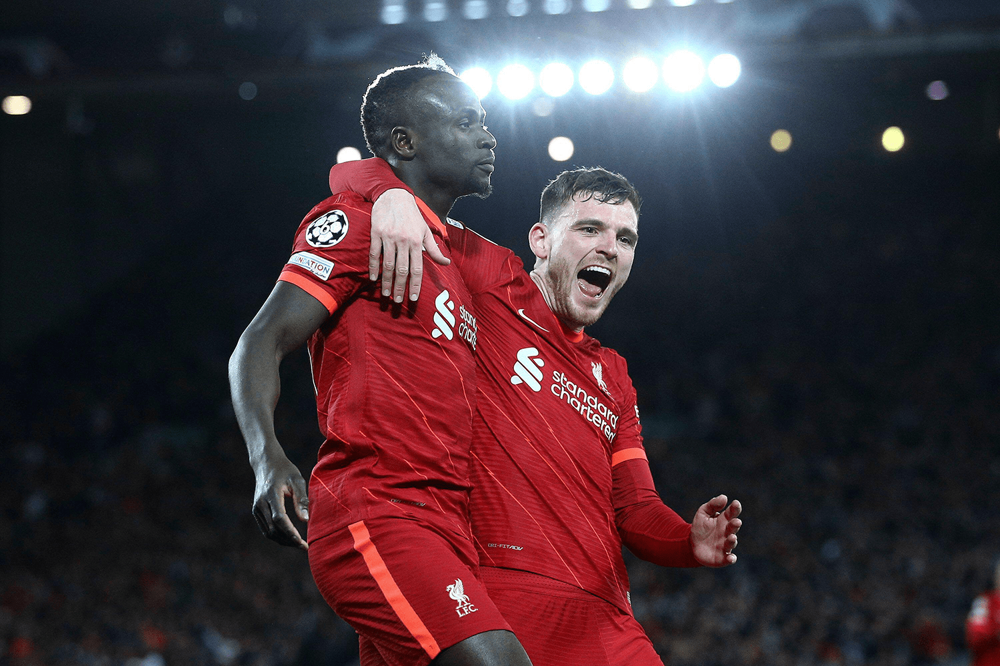

-1

In [5]:
# import the necessary packages
import imutils
import cv2
from google.colab.patches import cv2_imshow
# load the input image and show its dimensions, keeping in mind that
# images are represented as a multi-dimensional NumPy array with
# shape no. rows (height) x no. columns (width) x no. channels (depth)
image = cv2.imread("jp.png")
(h, w, d) = image.shape
print("width={}, height={}, depth={}".format(w, h, d))
# display the image to our screen -- we will need to click the window
# open by OpenCV and press a key on our keyboard to continue execution
cv2_imshow(image)
cv2.waitKey(0)

What is a pixel?

All images consist of pixels which are the raw building blocks of images. Images are made of pixels in a grid. A 640 x 480 image has 640 columns (the width) and 480 rows (the height). There are 640 * 480 = 307200 pixels in an image with those dimensions.

Each pixel in a grayscale image has a value representing the shade of gray. In OpenCV, there are 256 shades of gray — from 0 to 255. So a grayscale image would have a grayscale value associated with each pixel.

Pixels in a color image have additional information. There are several color spaces that you’ll soon become familiar with as you learn about image processing. For simplicity let’s only consider the RGB color space.




What is a pixel?

All images consist of pixels which are the raw building blocks of images. Images are made of pixels in a grid. A 640 x 480 image has 640 columns (the width) and 480 rows (the height). There are 640 * 480 = 307200 pixels in an image with those dimensions.

Each pixel in a grayscale image has a value representing the shade of gray. In OpenCV, there are 256 shades of gray — from 0 to 255. So a grayscale image would have a grayscale value associated with each pixel.

Pixels in a color image have additional information. There are several color spaces that you’ll soon become familiar with as you learn about image processing. For simplicity let’s only consider the RGB color space.

In OpenCV color images in the RGB (Red, Green, Blue) color space have a 3-tuple associated with each pixel: (B, G, R) .

Notice the ordering is BGR rather than RGB. This is because when OpenCV was first being developed many years ago the standard was BGR ordering. Over the years, the standard has now become RGB but OpenCV still maintains this “legacy” BGR ordering to ensure no existing code breaks.

Each value in the BGR 3-tuple has a range of [0, 255] . How many color possibilities are there for each pixel in an RGB image in OpenCV? That’s easy: 256 * 256 * 256 = 16777216 .

In [6]:
# access the RGB pixel located at x=50, y=100, keepind in mind that
# OpenCV stores images in BGR order rather than RGB
(B, G, R) = image[100, 50]
print("R={}, G={}, B={}".format(R, G, B))

R=30, G=41, B=55


Array slicing and cropping

Extracting “regions of interest” (ROIs) is an important skill for image processing.

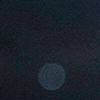

-1

In [9]:
# extract a 100x100 pixel square ROI (Region of Interest) from the
# input image starting at x=320,y=60 at ending at x=420,y=160
roi = image[60:160, 320:420]
cv2_imshow(roi)
cv2.waitKey(0)

Resizing images

Resizing images is important for a number of reasons. First, you might want to resize a large image to fit on your screen. Image processing is also faster on smaller images because there are fewer pixels to process. In the case of deep learning, we often resize images, ignoring aspect ratio, so that the volume fits into a network which requires that an image be square and of a certain dimension.

Let’s resize our original image to 200 x 200 pixels:



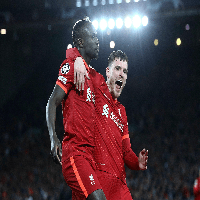

-1

In [11]:
# resize the image to 200x200px, ignoring aspect ratio
resized = cv2.resize(image, (200, 200))
cv2_imshow(resized)
cv2.waitKey(0)

Let’s calculate the aspect ratio of the original image and use it to resize an image so that it doesn’t appear squished and distorted:

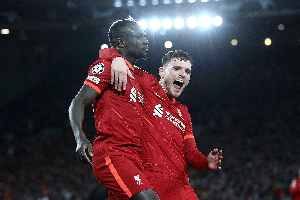

-1

In [12]:
# fixed resizing and distort aspect ratio so let's resize the width
# to be 300px but compute the new height based on the aspect ratio
r = 300.0 / w
dim = (300, int(h * r))
resized = cv2.resize(image, dim)
cv2_imshow(resized)
cv2.waitKey(0)

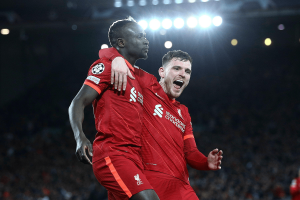

-1

In [13]:
# manually computing the aspect ratio can be a pain so let's use the
# imutils library instead
resized = imutils.resize(image, width=300)
cv2_imshow(resized)
cv2.waitKey(0)

Rotating an image

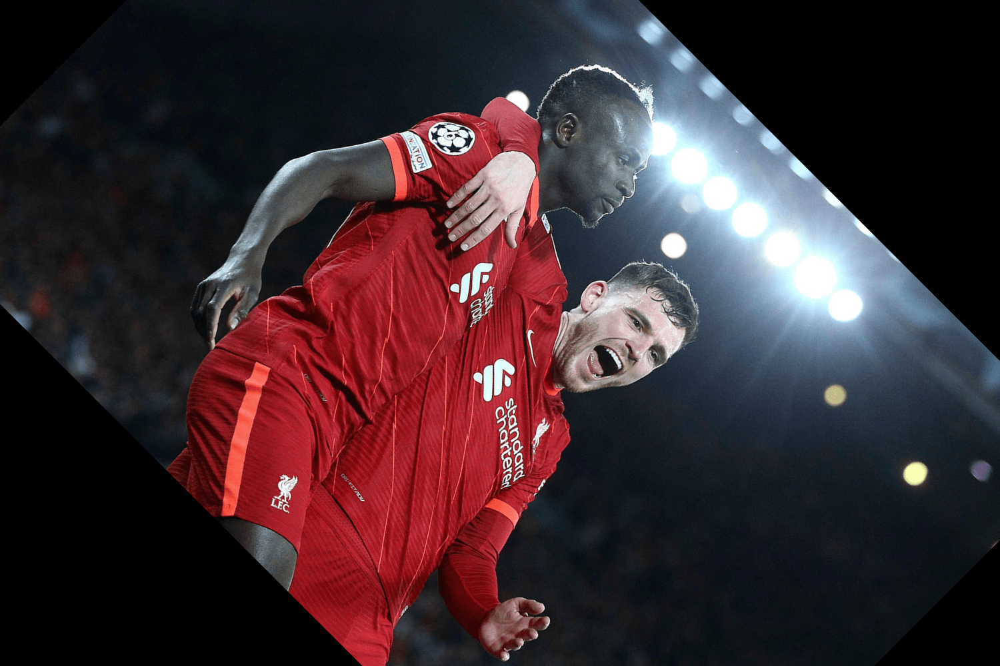

-1

In [14]:
# let's rotate an image 45 degrees clockwise using OpenCV by first
# computing the image center, then constructing the rotation matrix,
# and then finally applying the affine warp
center = (w // 2, h // 2)
M = cv2.getRotationMatrix2D(center, -45, 1.0)
rotated = cv2.warpAffine(image, M, (w, h))
cv2_imshow(rotated)
cv2.waitKey(0)

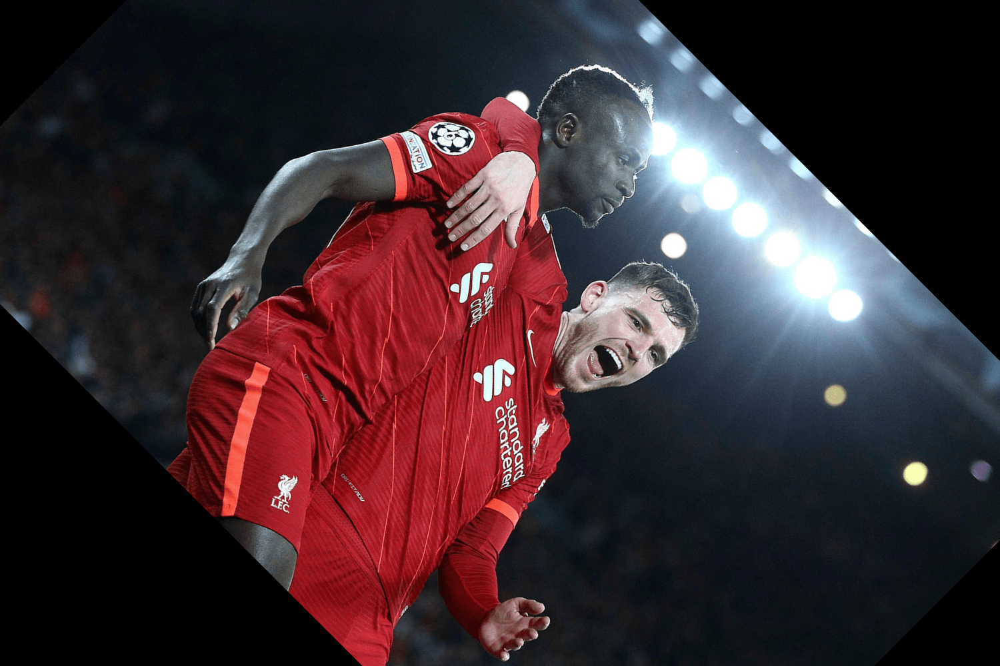

-1

In [15]:
# rotation can also be easily accomplished via imutils with less code
rotated = imutils.rotate(image, -45)
cv2_imshow(rotated)
cv2.waitKey(0)

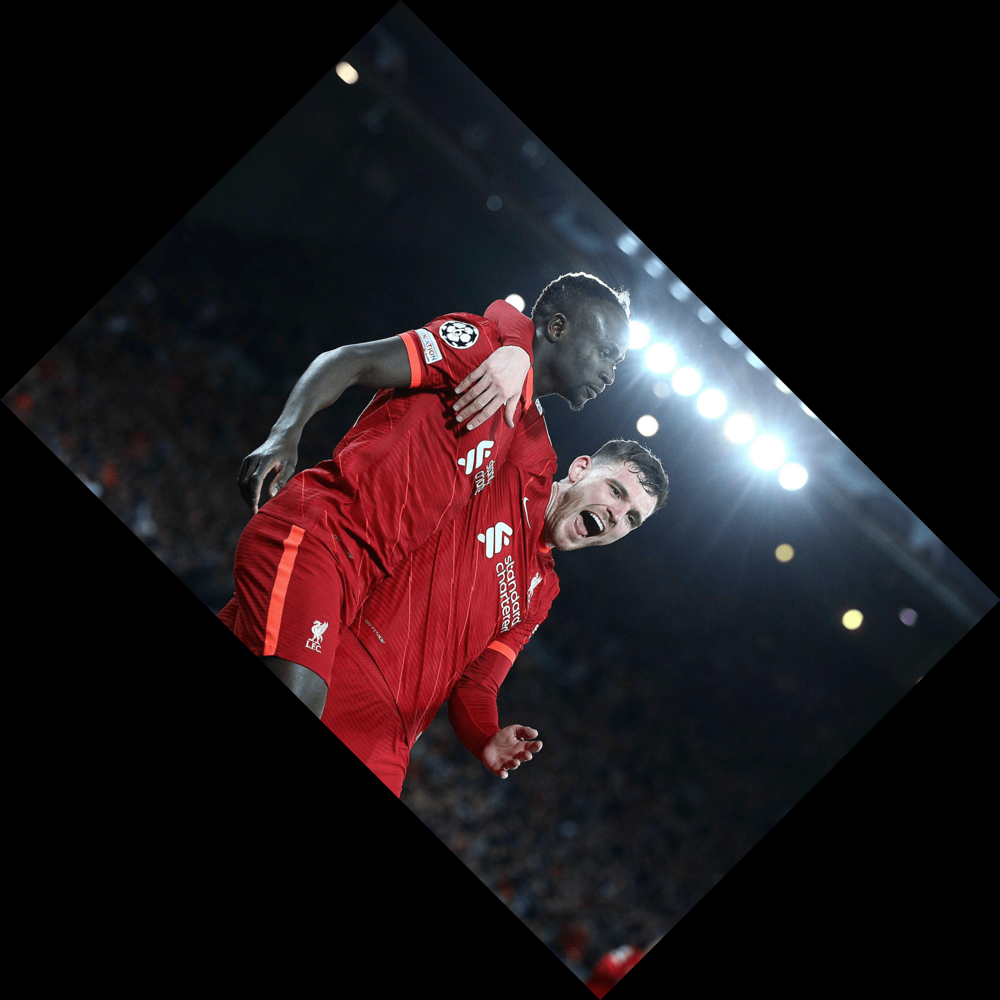

-1

In [16]:
# OpenCV doesn't "care" if our rotated image is clipped after rotation
# so we can instead use another imutils convenience function to help
# us out
rotated = imutils.rotate_bound(image, 45)
cv2_imshow(rotated)
cv2.waitKey(0)

Smoothing an image

In many image processing pipelines, we must blur an image to reduce high-frequency noise, making it easier for our algorithms to detect and understand the actual contents of the image rather than just noise that will “confuse” our algorithms.

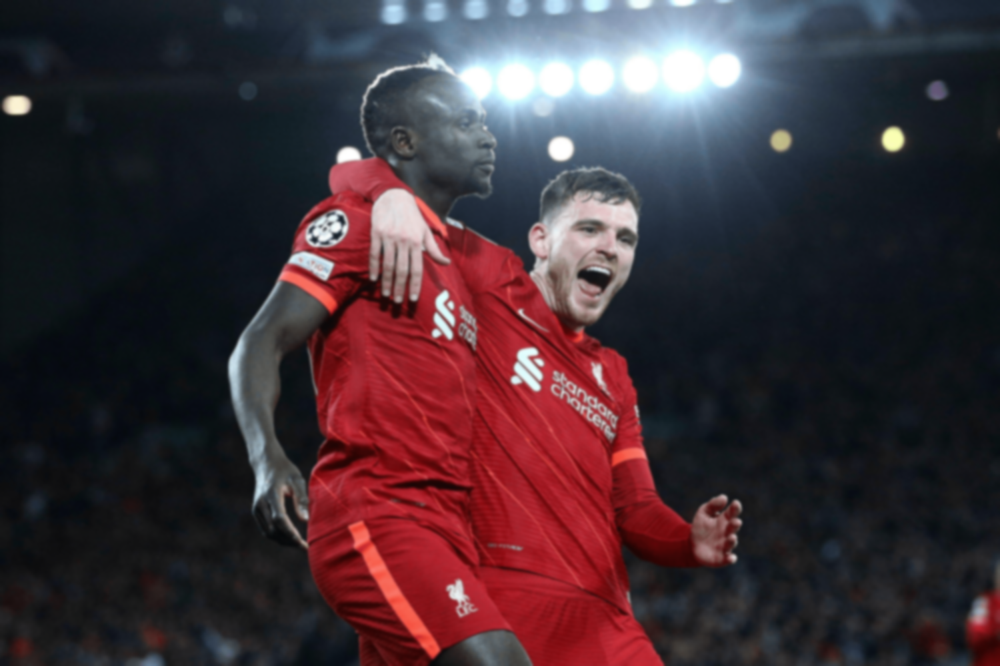

-1

In [17]:
# apply a Gaussian blur with a 11x11 kernel to the image to smooth it,
# useful when reducing high frequency noise
blurred = cv2.GaussianBlur(image, (11, 11), 0)
cv2_imshow(blurred)
cv2.waitKey(0)

Drawing on an image

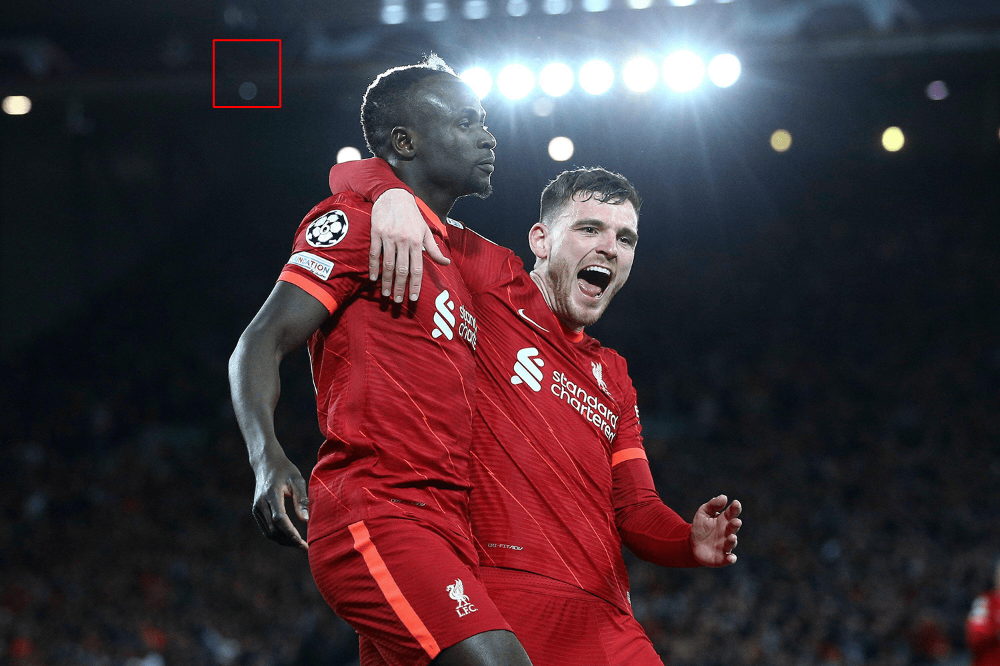

-1

In [18]:
# draw a 2px thick red rectangle surrounding the face
output = image.copy()
cv2.rectangle(output, (320, 60), (420, 160), (0, 0, 255), 2)
cv2_imshow(output)
cv2.waitKey(0)

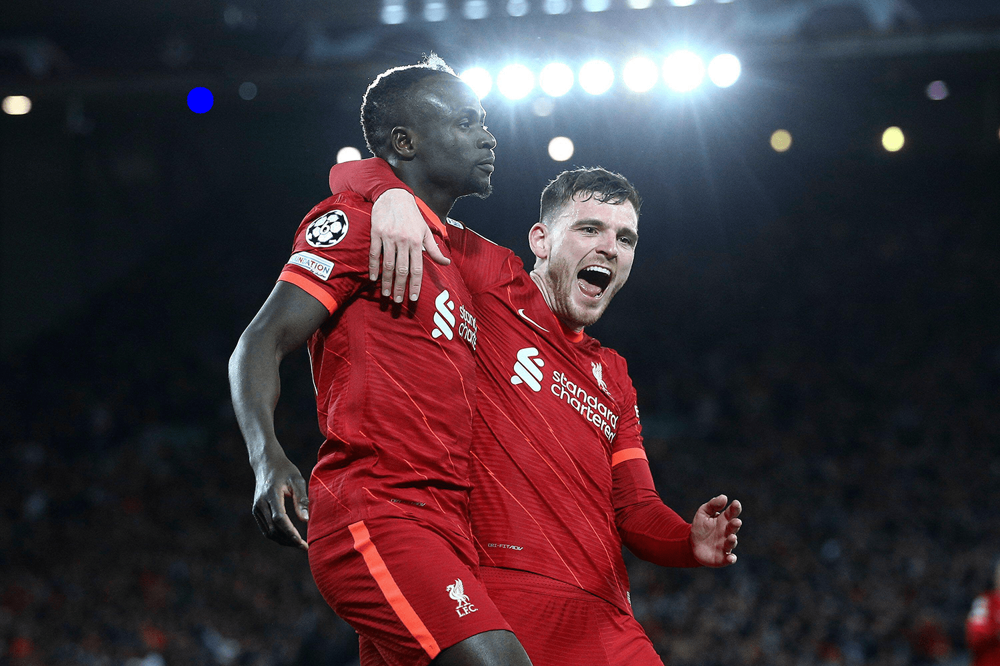

-1

In [19]:
# draw a blue 20px (filled in) circle on the image centered at
# x=300,y=150
output = image.copy()
cv2.circle(output, (300, 150), 20, (255, 0, 0), -1)
cv2_imshow(output)
cv2.waitKey(0)

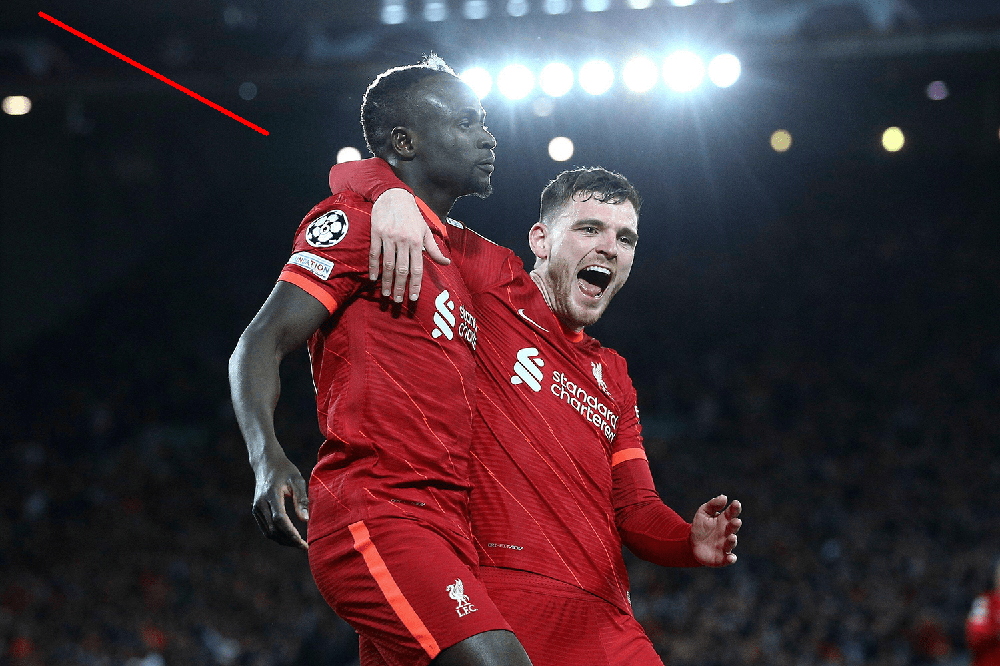

-1

In [20]:
# draw a 5px thick red line from x=60,y=20 to x=400,y=200
output = image.copy()
cv2.line(output, (60, 20), (400, 200), (0, 0, 255), 5)
cv2_imshow(output)
cv2.waitKey(0)

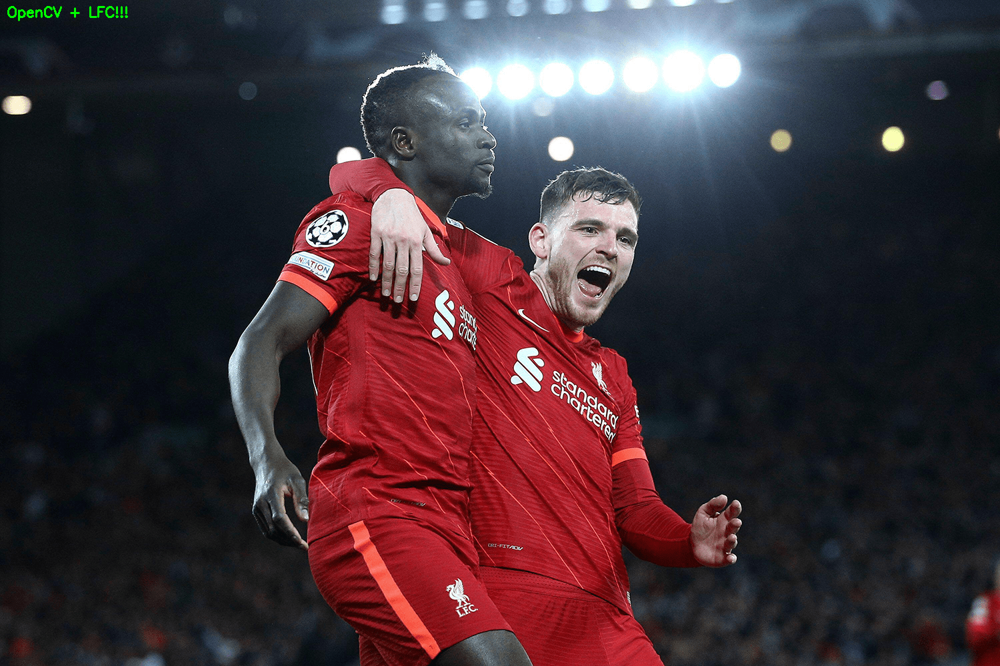

-1

In [21]:
# draw green text on the image
output = image.copy()
cv2.putText(output, "OpenCV + LFC!!!", (10, 25), 
	cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)
cv2_imshow(output)
cv2.waitKey(0)

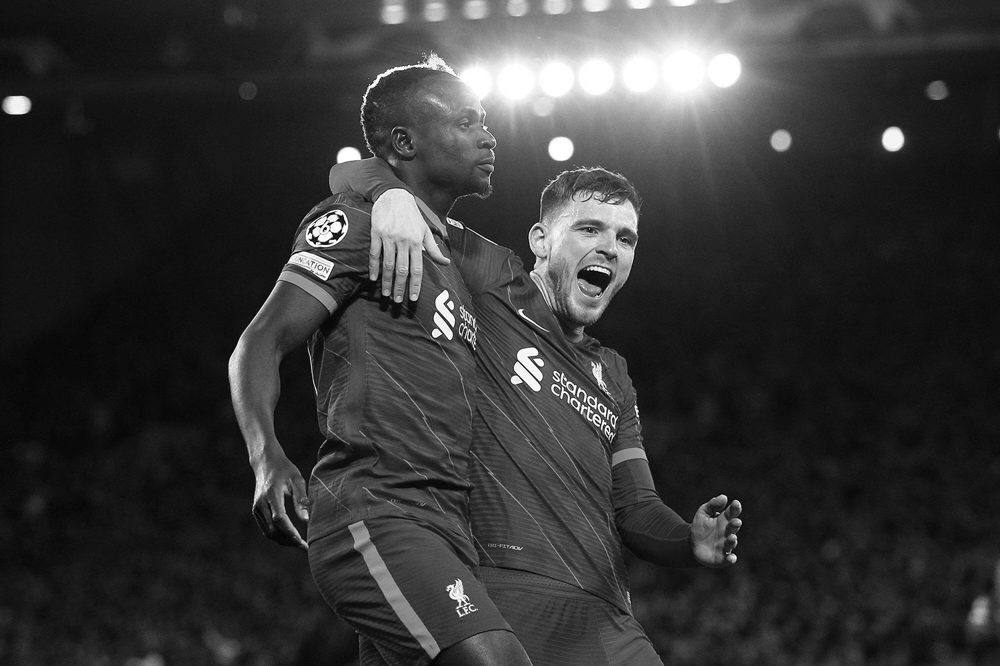

-1

In [23]:
# convert the image to grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray)
cv2.waitKey(0)

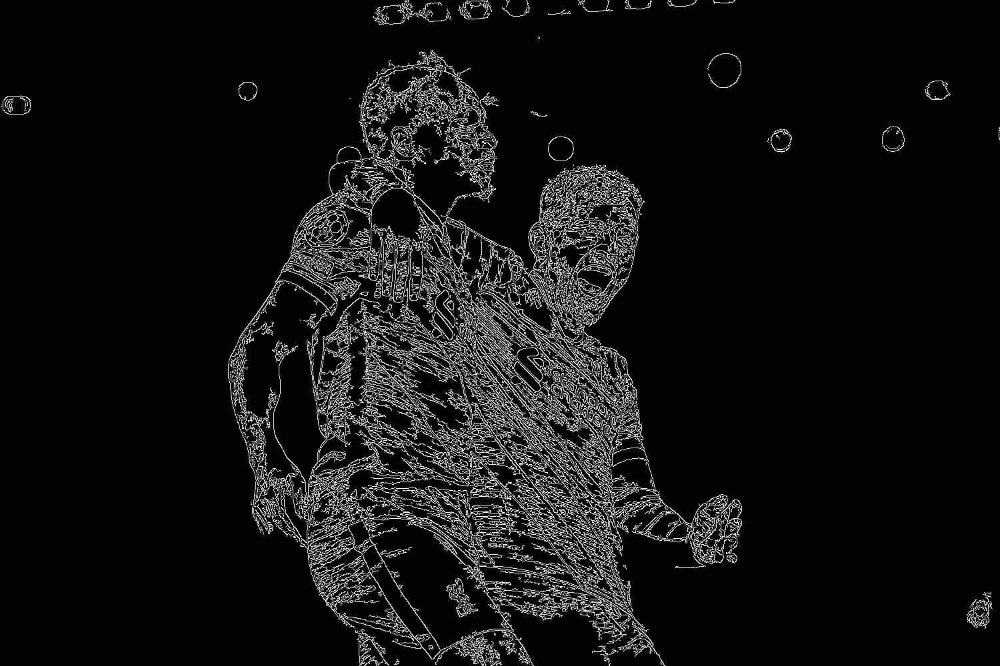

-1

In [24]:
# applying edge detection we can find the outlines of objects in
# images
edged = cv2.Canny(gray, 30, 150)
cv2_imshow(edged)
cv2.waitKey(0)

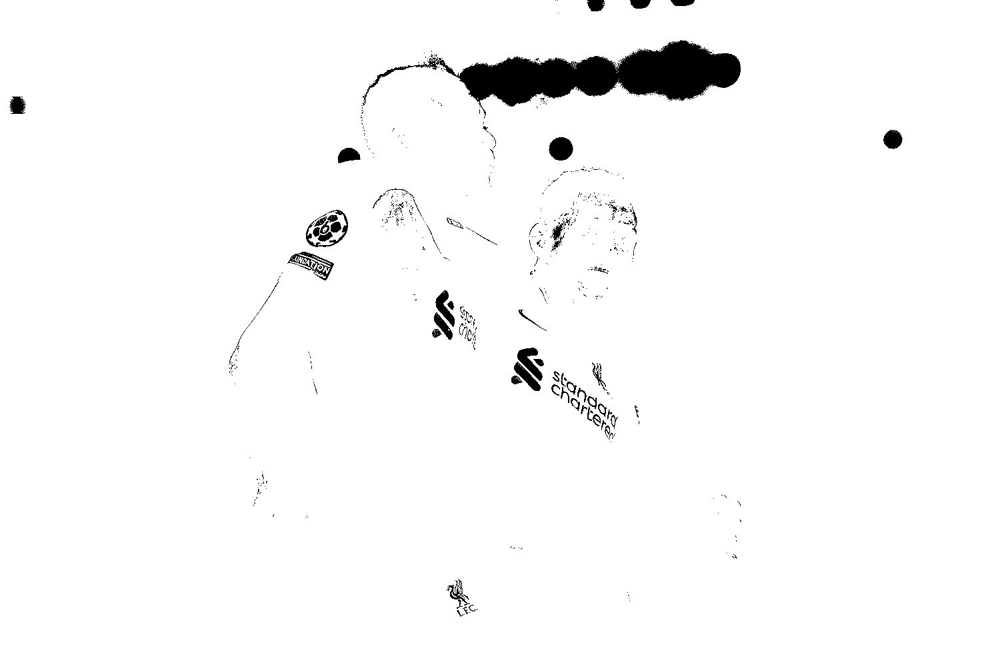

-1

In [26]:
# threshold the image by setting all pixel values less than 225
# to 255 (white; foreground) and all pixel values >= 225 to 255
# (black; background), thereby segmenting the image
thresh = cv2.threshold(gray, 225, 255, cv2.THRESH_BINARY_INV)[1]
cv2_imshow(thresh)
cv2.waitKey(0)

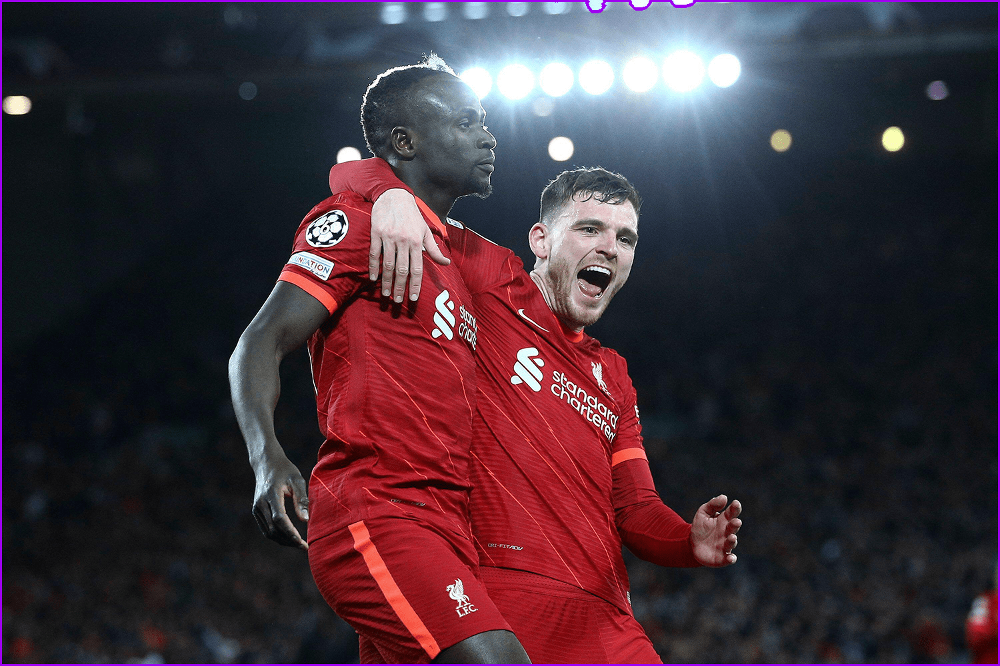

In [30]:
# find contours (i.e., outlines) of the foreground objects in the
# thresholded image
cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL,
	cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
output = image.copy()
# loop over the contours
for c in cnts:
	# draw each contour on the output image with a 3px thick purple
	# outline, then display the output contours one at a time
	cv2.drawContours(output, [c], -1, (240, 0, 159), 3)
	cv2_imshow(output)
	cv2.waitKey(0)

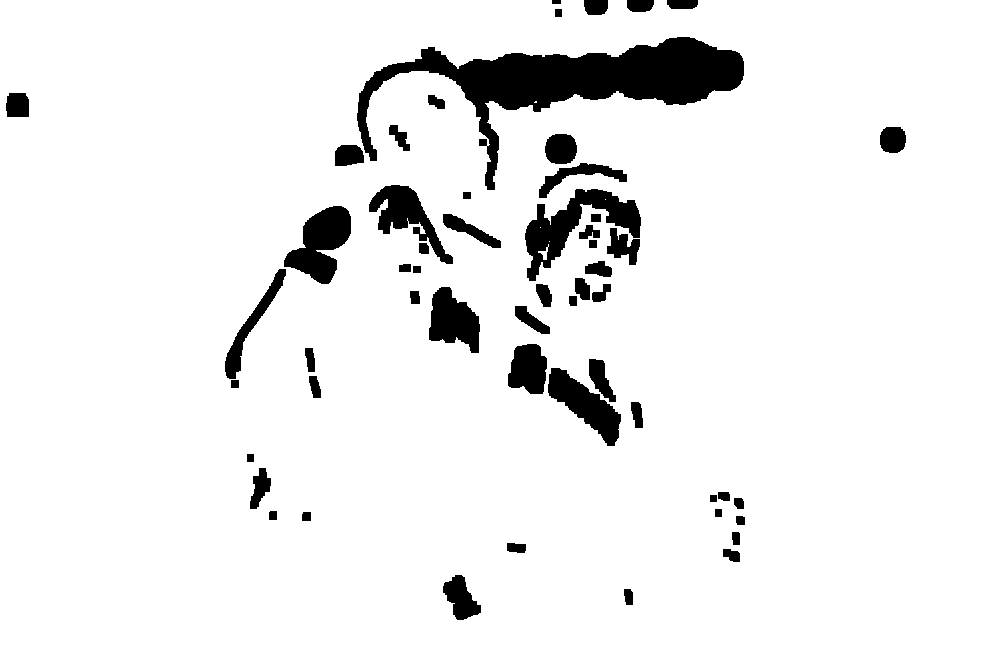

-1

In [31]:
# we apply erosions to reduce the size of foreground objects
mask = thresh.copy()
mask = cv2.erode(mask, None, iterations=5)
cv2_imshow( mask)
cv2.waitKey(0)